In [1]:
import geopandas as gpd

In [ ]:
%$timeit 3
sabs1516 = gpd.read_file("../data/nces/sabs/SABS_1516/SABS_1516.shp")

In [ ]:
sabs1314 = gpd.read_file("../data/nces/sabs/SABS_1314/SABS_1314.shp")

In [ ]:
sabs1314.to_parquet("../data/nces/sabs/sabs_1314.parquet", compression='brotli')

In [ ]:
sabs1516.to_parquet("../data/nces/sabs/SABS_1516/sabs_1516_snappy.parquet")

In [ ]:
sabs1516.to_parquet("../data/nces/sabs/SABS_1516/sabs_1516_brotli.parquet", compression='brotli')

In [141]:
df = gpd.read_parquet('/Users/knaaptime/Dropbox/projects/geosnap4ed/data/nces/sabs/sabs_1314.parquet')

In [142]:
df.head()

,SrcName,ncessch,schnam,leaid,updateDate,gslo,gshi,defacto,stAbbrev,sLevel,openEnroll,MultiBdy,Shape_Leng,Shape_Area,geometry
0,None,010000500870,ALA AVENUE MIDDLE SCH,0100005,2015-03-31,07,08,Yes,AL,2,0,0,121162.074569,6.899052e+07,"MULTIPOLYGON (((887269.849 1289268.272, 887269..."
1,None,010000500871,ALBERTVILLE HIGH SCH,0100005,2015-03-31,09,12,Yes,AL,3,0,0,121162.074569,6.899052e+07,"MULTIPOLYGON (((887269.849 1289268.272, 887269..."
2,None,010000500879,EVANS ELEM SCH,0100005,2015-03-31,05,06,Yes,AL,2,0,0,121162.074569,6.899052e+07,"MULTIPOLYGON (((887269.849 1289268.272, 887269..."
3,None,010000500889,ALBERTVILLE ELEM SCH,0100005,2015-03-31,03,04,Yes,AL,1,0,0,121162.074569,6.899052e+07,"MULTIPOLYGON (((887269.849 1289268.272, 887269..."
4,None,010000501616,BIG SPRING LAKE KINDERG SCH,0100005,2015-03-31,KG,KG,Yes,AL,1,0,0,121162.074569,6.899052e+07,"MULTIPOLYGON (((887269.849 1289268.272, 887269..."


In [143]:
df=df[df.stAbbrev=='MD']

In [ ]:
df.head()

In [ ]:
cd ../data/nces/sabs

In [ ]:
import quilt3
p = quilt3.Package()

top_hash = p.build("nces/sabs", "s3://spatial-ucr")

In [140]:
md_sabs = gpd.read_parquet('/Users/knaaptime/Dropbox/projects/geosnap4ed/data/nces/sabs/SABS_1516/sabs_1516_brotli.parquet', filters=[('stAbbrev', '==', 'MD')])

FileNotFoundError: /Users/knaaptime/Dropbox/projects/geosnap4ed/data/nces/sabs/SABS_1516/sabs_1516_brotli.parquet

In [2]:
import pandas as pd

In [ ]:
nonresp13 = pd.read_excel("../../aw/SABS_1314/District_Nonresponse.xls")

In [ ]:
nonresp13.to_csv('district_nonresponse_1314.csv')

In [ ]:
nonresp15 = pd.read_excel("../../aw/SABS_1516/District_Nonresponse.xls")

In [ ]:
nonresp15.to_csv('district_nonresponse_1516.csv')

In [ ]:
p.set_dir('.')

In [ ]:
p.push(
   "nces/sabs", 
   "s3://spatial-ucr",
    message="Init nces sabs data"
)

In [ ]:
p = quilt3.Package.browse('nces/sabs', "s3://spatial-ucr",)

In [ ]:
import fsspec

In [ ]:
of = fsspec.open("filecache::s3://spatial-ucr/nces/sabs/sabs_1314.parquet",
                 s3={'anon': True}, filecache={'cache_storage':'/tmp/files'})

In [ ]:
md_sabs13 = gpd.read_parquet("s3://spatial-ucr/nces/sabs/sabs_1314.parquet", filters=[('stAbbrev', '==', 'MD'), ('sLevel', '==', 1)] )

In [10]:
md_sabs13_high = gpd.read_parquet("s3://spatial-ucr/nces/sabs/sabs_1314.parquet", filters=[('stAbbrev', '==', 'MD'), ('sLevel', '==', 3)] )

In [ ]:
md_sabs13_high.plot()

In [ ]:
md_sabs13_high.unary_union.__geo_interface__

In [ ]:
box = 

In [3]:
import rasterio as rio

In [4]:
raster = rio.open('/Users/knaaptime/Downloads/NLCD_Land_Cover_L48_20190424_full_zip/nlcd_2016.tif')

In [5]:
raster.crs.data

{'proj': 'aea',
 'lat_0': 23,
 'lon_0': -96,
 'lat_1': 29.5,
 'lat_2': 45.5,
 'x_0': 0,
 'y_0': 0,
 'datum': 'WGS84',
 'units': 'm',
 'no_defs': True}

In [6]:
import rasterio.mask
import matplotlib.pyplot as plt

In [7]:
nlcd_path = '/Users/knaaptime/Downloads/NLCD_Land_Cover_L48_20190424_full_zip/nlcd_2016.tif'

In [11]:
md_sabs13_high =  md_sabs13_high.to_crs(raster.crs.data)

In [12]:
f = [md_sabs13_high.explode().unary_union.__geo_interface__]

In [8]:
import tempfile
import os
import pathlib
from rasterio import features

In [ ]:
with tempfile.mkdtemp() as tempdir:
    pass

In [39]:
with tempfile.TemporaryDirectory() as tempdir:
    with rio.open(nlcd_path) as src:
        out_image, out_transform = rio.mask.mask(src, f, crop=True)
        out_meta = src.meta
        
        out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})
        
        with rio.open(os.path.join("/Users/knaaptime/Downloads/output.tif"), "w", **out_meta) as dest:
            dest.write(out_image)
        with rio.open("/Users/knaaptime/Downloads/output.tif") as clipped:
            raster= clipped.read(1)
            shapes = list(features.shapes(raster))
            #gdf=gpd.GeoDataFrame.from_feat(shapes)

     #   out = list(rio.features.dataset_features(clipped))

In [110]:
with rio.open(nlcd_path) as src:  #read nationwide file
    out_image, _ = rio.mask.mask(src, f, crop=True)  # clip to AoI using a vector layer
    shapes = list(features.shapes(raster))  # convert regions to polygons
    #gdf=gpd.GeoDataFrame.from_feat(shapes)

In [119]:
def parse_geom(geom_str):
    if not geom_str:
        return None
    return shape(json.loads(geom_str)).replace("'", '"')

In [117]:
json.loads(str(shapes[0][0]).replace("'", '"'))

JSONDecodeError: Expecting value: line 1 column 38 (char 37)

In [103]:
out_image.shape

(1, 6969, 13536)

In [105]:
import numpy as np

In [102]:
out_image==22

array([[[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]]])

In [36]:
raster = [21, 22,23,24]

In [47]:
res = list(zip(*shapes))

In [134]:
geoms = pd.Series(res[0])

In [59]:
from shapely.geometry imoport Polygon

In [124]:
json.loads(str(geoms[0]).replace("'", '"'))

JSONDecodeError: Expecting value: line 1 column 38 (char 37)

In [125]:
str(geoms[0]).replace("'", '"')

'{"type": "Polygon", "coordinates": [[(10246.0, 1.0), (10246.0, 2.0), (10247.0, 2.0), (10247.0, 1.0), (10246.0, 1.0)]]}'

In [135]:
geoms[0]

{'type': 'Polygon',
 'coordinates': [[(10246.0, 1.0),
   (10246.0, 2.0),
   (10247.0, 2.0),
   (10247.0, 1.0),
   (10246.0, 1.0)]]}

In [137]:
q = ast.liunary_union_eval(str(geoms[0]))

In [138]:
q

{'type': 'Polygon',
 'coordinates': [[(10246.0, 1.0),
   (10246.0, 2.0),
   (10247.0, 2.0),
   (10247.0, 1.0),
   (10246.0, 1.0)]]}

In [126]:
import ast

In [142]:
import geopandas as gpd
import json
from shapely.geometry import shape

def parse_geom(geom_str):
    return shape(ast.literal_eval(geom_str))
geo =  geoms.apply(str).apply(parse_geom)
gdf = gpd.GeoDataFrame(geometry=geo)

In [143]:
geo

0          POLYGON ((10246 1, 10246 2, 10247 2, 10247 1, ...
1          POLYGON ((10240 2, 10240 3, 10241 3, 10241 2, ...
2          POLYGON ((10235 3, 10235 4, 10237 4, 10237 3, ...
3          POLYGON ((10247 3, 10247 4, 10248 4, 10248 5, ...
4          POLYGON ((10245 1, 10245 2, 10244 2, 10241 2, ...
                                 ...                        
1524790    POLYGON ((10301 6896, 10301 6897, 10302 6897, ...
1524791    POLYGON ((10396 6957, 10396 6958, 10397 6958, ...
1524792    POLYGON ((0 0, 0 6969, 13536 6969, 13536 4447,...
1524793    POLYGON ((8990 2940, 8990 2941, 8991 2941, 899...
1524794    POLYGON ((10421 6967, 10421 6968, 10422 6968, ...
Length: 1524795, dtype: object

In [145]:
gdf['type'] = res[1]

In [149]:
developed = gdf[gdf['type'].isin([21,22,23,24])]

In [150]:
developed.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 719419 entries, 4 to 1524783
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype   
---  ------    --------------   -----   
 0   geometry  719419 non-null  geometry
 1   type      719419 non-null  float64 
dtypes: float64(1), geometry(1)
memory usage: 16.5 MB


In [152]:
developed.unary_union

KeyboardInterrupt: 

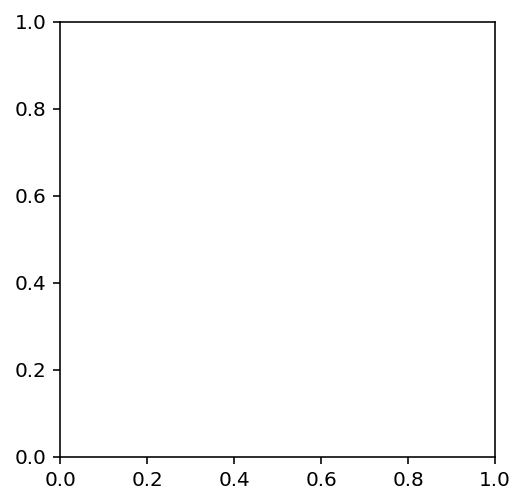

In [148]:
gdf[gdf['type'].isin([21,22,23,24])].plot('type', categorical=True)

In [61]:
newdict = {}

In [62]:
newdict['geometry'] = geoms[1]

In [65]:
from shapely.wkt import loads

In [71]:
newdict={
"type": "FeatureCollection",
"features": geoms}

In [84]:
geoms[0]

AttributeError: 'dict' object has no attribute 'to_frame'

In [73]:
newdict

{'type': 'FeatureCollection',
 'features': 0          {'type': 'Polygon', 'coordinates': [[(10246.0,...
 1          {'type': 'Polygon', 'coordinates': [[(10240.0,...
 2          {'type': 'Polygon', 'coordinates': [[(10235.0,...
 3          {'type': 'Polygon', 'coordinates': [[(10247.0,...
 4          {'type': 'Polygon', 'coordinates': [[(10245.0,...
                                  ...                        
 1524790    {'type': 'Polygon', 'coordinates': [[(10301.0,...
 1524791    {'type': 'Polygon', 'coordinates': [[(10396.0,...
 1524792    {'type': 'Polygon', 'coordinates': [[(0.0, 0.0...
 1524793    {'type': 'Polygon', 'coordinates': [[(8990.0, ...
 1524794    {'type': 'Polygon', 'coordinates': [[(10421.0,...
 Length: 1524795, dtype: object}

In [72]:
gpd.GeoDataFrame.from_features(newdict)

KeyError: 'geometry'

In [70]:
loads(str(geoms[1]))

ParseException: Unknown type: '{'TYPE':'


WKTReadingError: Could not create geometry because of errors while reading input.

In [60]:
Polygon(geoms[1])

KeyError: 0

In [52]:
vals = pd.Series(res[1])

In [50]:
res[1]

(41.0,
 82.0,
 43.0,
 41.0,
 21.0,
 43.0,
 81.0,
 21.0,
 42.0,
 21.0,
 22.0,
 21.0,
 21.0,
 22.0,
 43.0,
 21.0,
 21.0,
 81.0,
 41.0,
 21.0,
 22.0,
 22.0,
 43.0,
 22.0,
 21.0,
 41.0,
 81.0,
 43.0,
 42.0,
 41.0,
 81.0,
 43.0,
 21.0,
 21.0,
 42.0,
 41.0,
 21.0,
 43.0,
 81.0,
 41.0,
 41.0,
 43.0,
 42.0,
 21.0,
 21.0,
 22.0,
 43.0,
 43.0,
 42.0,
 41.0,
 43.0,
 21.0,
 21.0,
 22.0,
 21.0,
 43.0,
 41.0,
 43.0,
 81.0,
 42.0,
 21.0,
 41.0,
 21.0,
 41.0,
 22.0,
 43.0,
 42.0,
 81.0,
 41.0,
 41.0,
 43.0,
 81.0,
 52.0,
 41.0,
 22.0,
 21.0,
 43.0,
 52.0,
 52.0,
 81.0,
 43.0,
 41.0,
 41.0,
 42.0,
 22.0,
 21.0,
 21.0,
 21.0,
 41.0,
 43.0,
 43.0,
 42.0,
 43.0,
 42.0,
 81.0,
 42.0,
 22.0,
 43.0,
 22.0,
 41.0,
 41.0,
 21.0,
 43.0,
 41.0,
 22.0,
 21.0,
 41.0,
 43.0,
 43.0,
 41.0,
 43.0,
 42.0,
 22.0,
 21.0,
 22.0,
 11.0,
 41.0,
 43.0,
 42.0,
 22.0,
 43.0,
 90.0,
 43.0,
 90.0,
 42.0,
 43.0,
 42.0,
 42.0,
 81.0,
 21.0,
 22.0,
 90.0,
 43.0,
 43.0,
 42.0,
 41.0,
 41.0,
 22.0,
 52.0,
 21.0,
 41.0,
 43.0,
 41.0,

In [14]:
import pandas as pd

In [33]:
shapes[0]

{'type': 'Polygon',
 'coordinates': [[(10246.0, 1.0),
   (10246.0, 2.0),
   (10247.0, 2.0),
   (10247.0, 1.0),
   (10246.0, 1.0)]]}

In [43]:
shapes[2]

({'type': 'Polygon',
  'coordinates': [[(10235.0, 3.0),
    (10235.0, 4.0),
    (10237.0, 4.0),
    (10237.0, 3.0),
    (10235.0, 3.0)]]},
 43.0)

In [153]:
import json
json.loads(str(list(res[0])))

JSONDecodeError: Expecting property name enclosed in double quotes: line 1 column 3 (char 2)

In [ ]:
str(list(res[0]))

In [29]:
res[1]

(41.0,
 82.0,
 43.0,
 41.0,
 21.0,
 43.0,
 81.0,
 21.0,
 42.0,
 21.0,
 22.0,
 21.0,
 21.0,
 22.0,
 43.0,
 21.0,
 21.0,
 81.0,
 41.0,
 21.0,
 22.0,
 22.0,
 43.0,
 22.0,
 21.0,
 41.0,
 81.0,
 43.0,
 42.0,
 41.0,
 81.0,
 43.0,
 21.0,
 21.0,
 42.0,
 41.0,
 21.0,
 43.0,
 81.0,
 41.0,
 41.0,
 43.0,
 42.0,
 21.0,
 21.0,
 22.0,
 43.0,
 43.0,
 42.0,
 41.0,
 43.0,
 21.0,
 21.0,
 22.0,
 21.0,
 43.0,
 41.0,
 43.0,
 81.0,
 42.0,
 21.0,
 41.0,
 21.0,
 41.0,
 22.0,
 43.0,
 42.0,
 81.0,
 41.0,
 41.0,
 43.0,
 81.0,
 52.0,
 41.0,
 22.0,
 21.0,
 43.0,
 52.0,
 52.0,
 81.0,
 43.0,
 41.0,
 41.0,
 42.0,
 22.0,
 21.0,
 21.0,
 21.0,
 41.0,
 43.0,
 43.0,
 42.0,
 43.0,
 42.0,
 81.0,
 42.0,
 22.0,
 43.0,
 22.0,
 41.0,
 41.0,
 21.0,
 43.0,
 41.0,
 22.0,
 21.0,
 41.0,
 43.0,
 43.0,
 41.0,
 43.0,
 42.0,
 22.0,
 21.0,
 22.0,
 11.0,
 41.0,
 43.0,
 42.0,
 22.0,
 43.0,
 90.0,
 43.0,
 90.0,
 42.0,
 43.0,
 42.0,
 42.0,
 81.0,
 21.0,
 22.0,
 90.0,
 43.0,
 43.0,
 42.0,
 41.0,
 41.0,
 22.0,
 52.0,
 21.0,
 41.0,
 43.0,
 41.0,

In [28]:
g= gpd.GeoDataFrame(list(zip(*shapes)))

KeyboardInterrupt: 

In [1]:
from geosnap import datasets

Loading manifest: 100%|██████████| 3/3 [00:00<00:00, 1.93k/s]


In [2]:
codebook = datasets.codebook()

In [6]:
codebook.variable[codebook.variable.str.contains('house')]

51     n_household_recent_move
65     p_household_recent_move
148    median_household_income
149         n_total_households
151         n_white_households
153         n_black_households
155      n_hispanic_households
157         n_asian_households
Name: variable, dtype: object

In [136]:
raster.shape

(6969, 13536)

In [117]:
gpd.GeoSeries(res[0])

<ipython-input-117-f5d9e0e79643>:1: FutureWarning:     You are passing non-geometry data to the GeoSeries constructor. Currently,
    it falls back to returning a pandas Series. But in the future, we will start
    to raise a TypeError instead.
  gpd.GeoSeries(res[0])


0          {'type': 'Polygon', 'coordinates': [[(10246.0,...
1          {'type': 'Polygon', 'coordinates': [[(10240.0,...
2          {'type': 'Polygon', 'coordinates': [[(10235.0,...
3          {'type': 'Polygon', 'coordinates': [[(10247.0,...
4          {'type': 'Polygon', 'coordinates': [[(10245.0,...
                                 ...                        
1524790    {'type': 'Polygon', 'coordinates': [[(10301.0,...
1524791    {'type': 'Polygon', 'coordinates': [[(10396.0,...
1524792    {'type': 'Polygon', 'coordinates': [[(0.0, 0.0...
1524793    {'type': 'Polygon', 'coordinates': [[(8990.0, ...
1524794    {'type': 'Polygon', 'coordinates': [[(10421.0,...
Length: 1524795, dtype: object

{'proj': 'aea',
 'lat_0': 23,
 'lon_0': -96,
 'lat_1': 29.5,
 'lat_2': 45.5,
 'x_0': 0,
 'y_0': 0,
 'datum': 'WGS84',
 'units': 'm',
 'no_defs': True}

In [129]:
new = gpd.GeoDataFrame([pd.Series(res[1]), gpd.GeoSeries(res[0], name='geometry')])

<ipython-input-129-77ada06f37f3>:1: FutureWarning:     You are passing non-geometry data to the GeoSeries constructor. Currently,
    it falls back to returning a pandas Series. But in the future, we will start
    to raise a TypeError instead.
  new = gpd.GeoDataFrame([pd.Series(res[1]), gpd.GeoSeries(res[0], name='geometry')])


KeyboardInterrupt: 

In [127]:
new.crs=dest.crs.data

AttributeError: 'Series' object has no attribute 'crs'

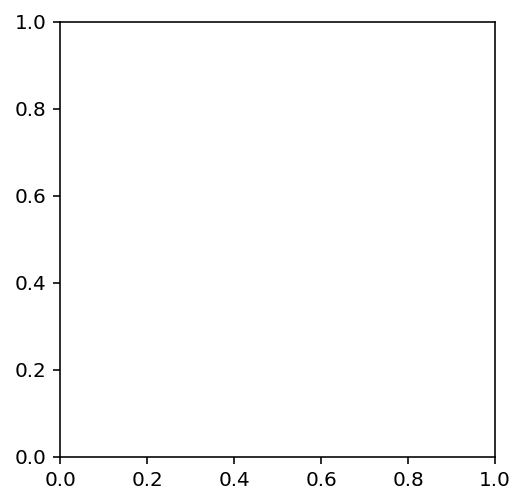

In [128]:
new.plot()

In [ ]:
new.plot()

In [112]:
gpd.GeoDataFrame.from_features(res[0])

KeyError: 'geometry'

In [109]:
shapes

[({'type': 'Polygon',
   'coordinates': [[(10246.0, 1.0),
     (10246.0, 2.0),
     (10247.0, 2.0),
     (10247.0, 1.0),
     (10246.0, 1.0)]]},
  41.0),
 ({'type': 'Polygon',
   'coordinates': [[(10240.0, 2.0),
     (10240.0, 3.0),
     (10241.0, 3.0),
     (10241.0, 2.0),
     (10240.0, 2.0)]]},
  82.0),
 ({'type': 'Polygon',
   'coordinates': [[(10235.0, 3.0),
     (10235.0, 4.0),
     (10237.0, 4.0),
     (10237.0, 3.0),
     (10235.0, 3.0)]]},
  43.0),
 ({'type': 'Polygon',
   'coordinates': [[(10247.0, 3.0),
     (10247.0, 4.0),
     (10248.0, 4.0),
     (10248.0, 5.0),
     (10249.0, 5.0),
     (10249.0, 3.0),
     (10247.0, 3.0)]]},
  41.0),
 ({'type': 'Polygon',
   'coordinates': [[(10245.0, 1.0),
     (10245.0, 2.0),
     (10244.0, 2.0),
     (10241.0, 2.0),
     (10241.0, 3.0),
     (10242.0, 3.0),
     (10242.0, 5.0),
     (10243.0, 5.0),
     (10243.0, 6.0),
     (10246.0, 6.0),
     (10246.0, 4.0),
     (10245.0, 4.0),
     (10245.0, 3.0),
     (10246.0, 3.0),
     (10246

In [92]:
for i in shapes:
    print(i[0])

In [ ]:
with tempfile.TemporaryDirectory() as tempdir:
    with rio.open(nlcd_path) as src:
        out_image, out_transform = rio.mask.mask(src, f, crop=True)
        out_meta = src.meta
        
        out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})


    
        lons = np.empty(shape=(1, out_img.shape[1], out_img.shape[2]))
        lats = np.empty(shape=(1, out_img.shape[1], out_img.shape[2]))

        for i in range(out_img.shape[1]):
            for j in range(out_img.shape[2]):
                lons[0][i][j] = (out_transform * (j, j))[0]  # Only index j.
                lats[0][i][j] = (out_transform * (i, i))[1]  # Only indexes of longitudes!

In [ ]:
with rio.open("/Users/knaaptime/Downloads/output.tif") as clipped:
    out = list(rio.features.dataset_features(clipped, 1))

In [ ]:
gpd.GeoDataFrame.from_features(out).plot()

TypeError: Invalid shape (1, 6969, 13536) for image data

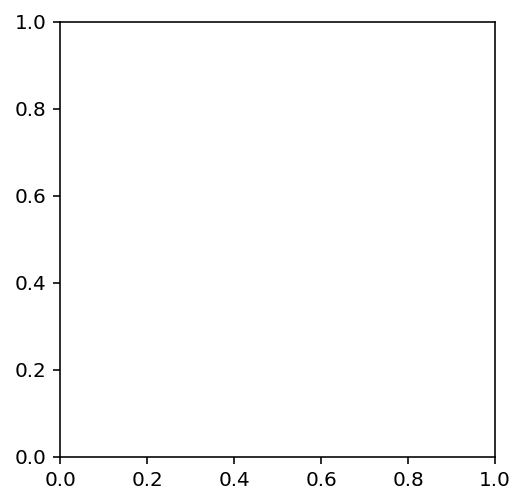

In [70]:
plt.imshow(out_image, cmap='pink')

In [ ]:
md_sabs13.convex_hull.__geo_interface__

In [ ]:
import json
d= [json.loads(md_sabs13.to_json())['features'][0]['geometry']]

In [ ]:
x = md_sabs13.unary_union.__geo_interface__['features'][0]['geometry']

In [ ]:
d

In [ ]:
md_sabs13.crs

In [ ]:
sabs13.plot()

In [ ]:
gdf = p['sabs_1314.parquet'].deserialize(gpd.read_parquet)

In [ ]:
from geosnap import datasets

In [ ]:
tracts = datasets.tracts_2010()

In [ ]:
geosnap.io.store_census()

In [ ]:
import geosnap

In [ ]:
md = tracts[tracts.geoid.str.startswith('24')]

In [ ]:
md.plot()

In [ ]:
gpd.read_parquet?